# Experiment # 3. - TRIMAP as pre- and post-processing step.

**Semi-Supervised Learning with TRIMAP**:
- Apply Uniform Manifold Approximation and Projection (TRIMAP) for DR on node features before and after training a semi-supervised GNN model.
- Evaluate the model on a more complex dataset like Citeseer, focusing on the impact of DR on label propagation and the learning of node representations.

Import section:

In [11]:
import torch
import torch.nn.functional as F
from torch_geometric.datasets import Planetoid
from torch_geometric.nn import GCNConv
from trimap import TRIMAP
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
import warnings
from utils import *

random_state = 0
random.seed(0)
torch.manual_seed(0)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
warnings.filterwarnings('ignore', message="n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.")
warnings.filterwarnings('ignore', message="Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.")
warnings.filterwarnings('ignore', message="Graph is not fully connected, spectral embedding may not work as expected.")
print("Is cuda available?", torch.cuda.is_available())

Is cuda available? True


## 1. Training the model on original features

Loading the CiteSeer dataset:

In [12]:
dataset = Planetoid(root='.', name='Cora')
data = dataset[0].to(device) # Move data to GPU

# prepare variables for further TRIMAP experiments
data_x_cpu = dataset[0].x.cpu().detach().numpy()
data_y_cpu = dataset[0].y.cpu().numpy()

Defining the GCN model and optimizer:

In [13]:
model = GCN(input_dim=dataset.num_node_features, hidden_dim=64, output_dim=dataset.num_classes).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

Training loop and model evaluation:

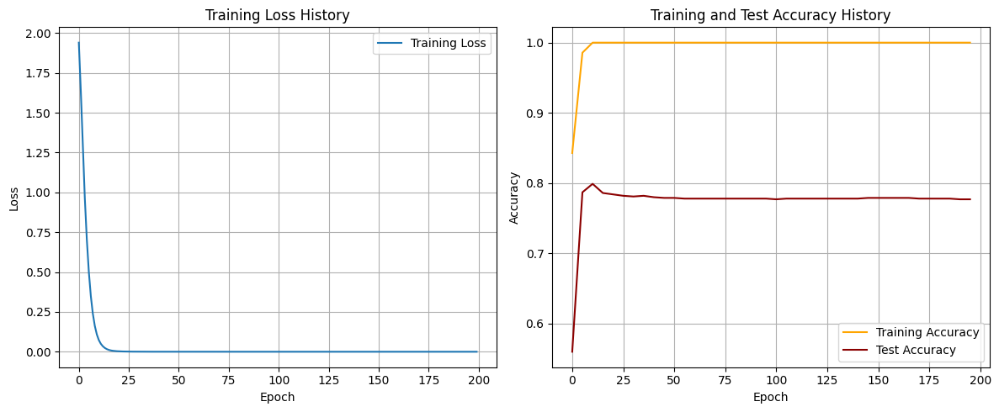

Accuracy: 0.7780, Precision: 0.7596, Recall: 0.8060, F1 Score: 0.7736


In [14]:
n_epochs = 200
loss_history, train_acc_history, test_acc_history = train_loop(n_epochs, model, optimizer, data)

plot_training_history(loss_history, train_acc_history, test_acc_history, grid=True)
   
accuracy, precision, recall, f1 = evaluate_model(model, data)
print(f"Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

## 2. TRIMAP as post-processing step
In this section the TRIMAP visualisation is prepared using the output of the model trained on original features.

In [15]:
model = GCN(input_dim=dataset.num_node_features, hidden_dim=64, output_dim=16).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
train_loop(200, model, optimizer, data)

# Extract node representations
model.eval()
with torch.no_grad():
    embeddings = model(data)

embeddings = embeddings.cpu().numpy()

### 2.1 Default TRIMAP

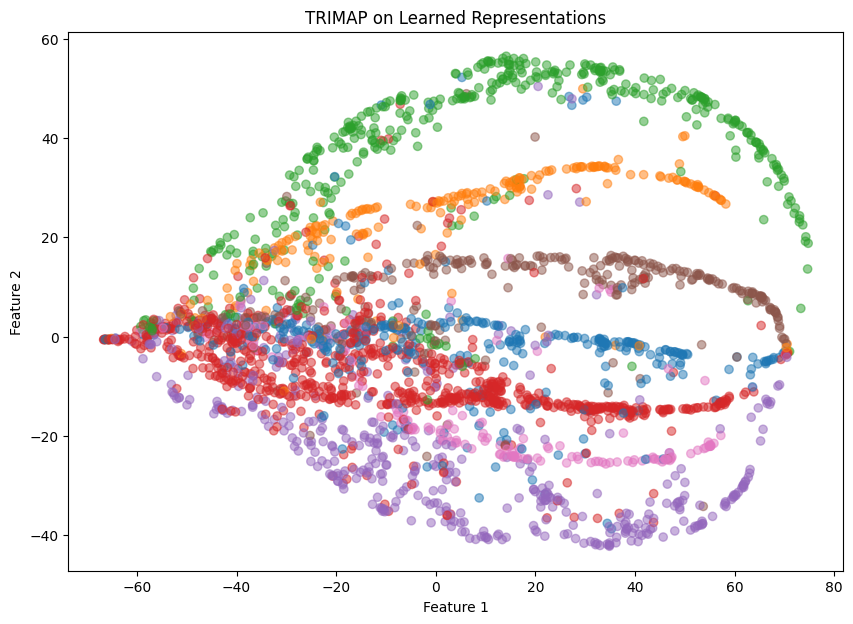

In [16]:
# Apply TRIMAP on Learned Node Representations
umap_post = TRIMAP(n_dims=2)
embeddings_umap_post = umap_post.fit_transform(embeddings)

visualise(embeddings_umap_post, data_y_cpu, 'TRIMAP on Learned Representations')

### 2.2 Fine-tuning TRIMAP

#### 2.2.1 distance vs n_inliners vs n_outliers

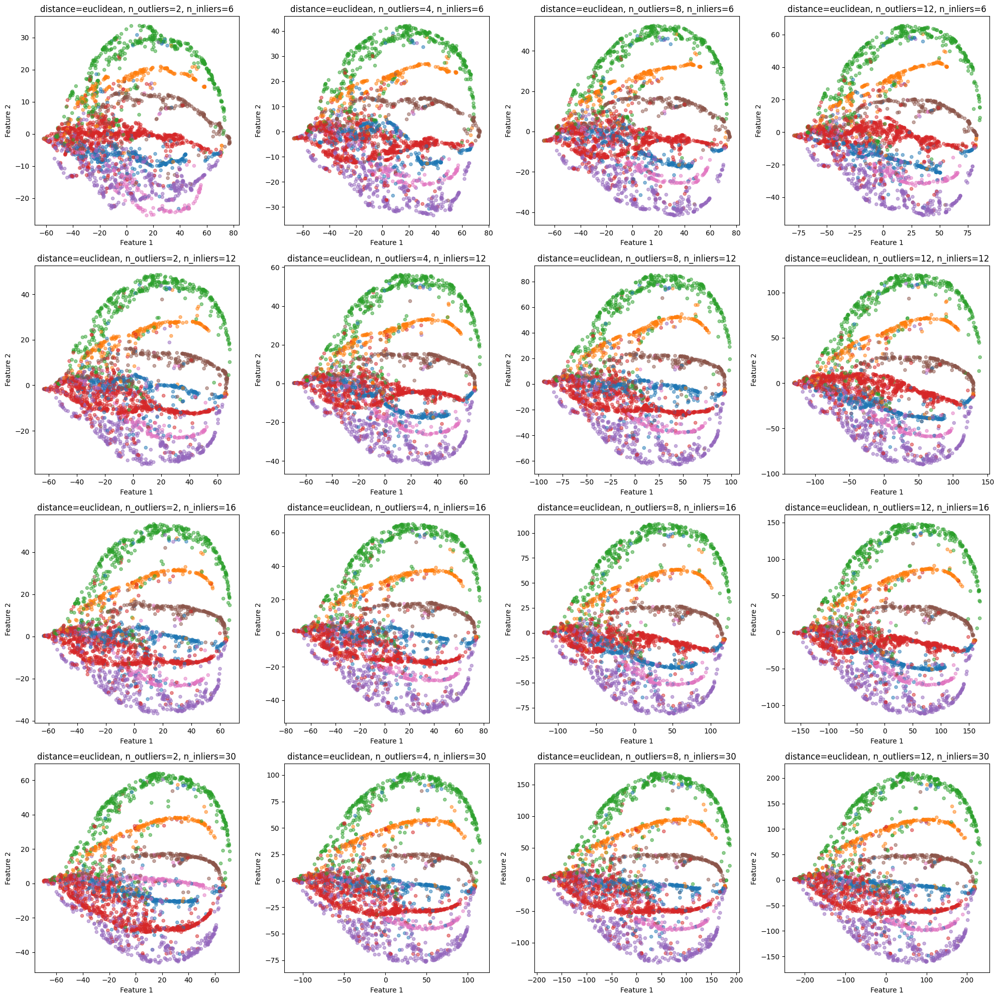

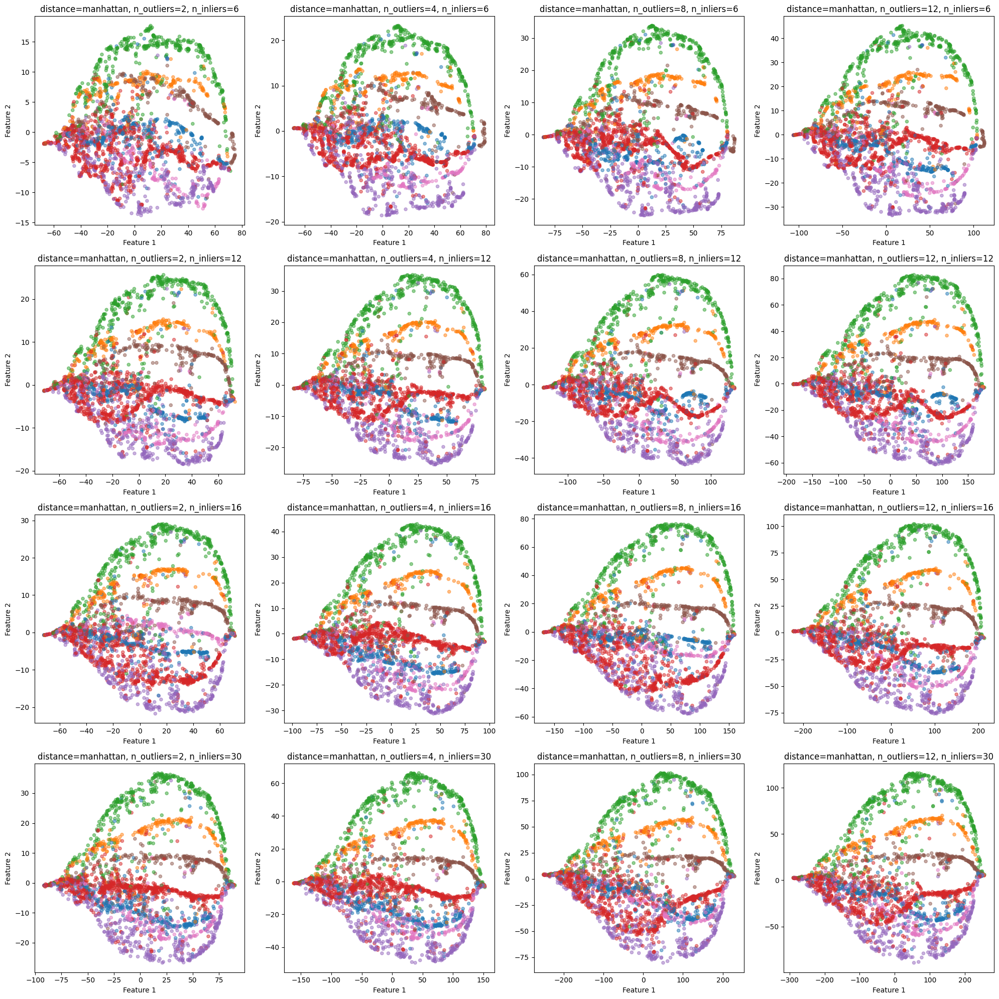

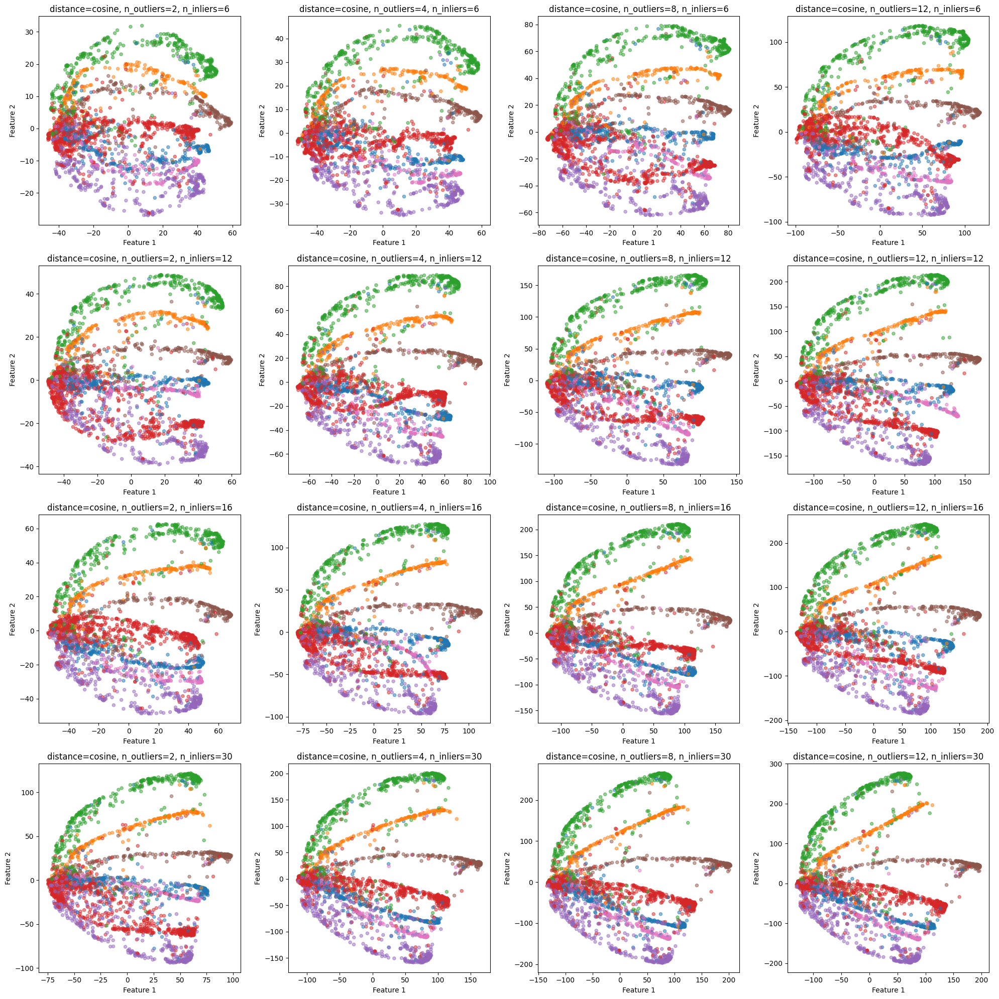

In [20]:
for distance in ['euclidean', 'manhattan', 'cosine']:
    fig, axs = plt.subplots(4, 4, figsize=(20, 20)) 
    axs = axs.flatten()
    i = 0
    for n_inliers in [6, 12, 16, 30]:
        for n_outliers in [2, 4, 8, 12]:
            umap_post = TRIMAP(n_dims=2 , n_outliers=n_outliers, n_inliers=n_inliers, distance=distance)
            umap_results = umap_post.fit_transform(embeddings)
    
            plot_no_show(axs[i], umap_results, data_y_cpu, f'distance={distance}, n_outliers={n_outliers}, n_inliers={n_inliers}', size=20)

            i += 1


    plt.tight_layout()
    plt.show()

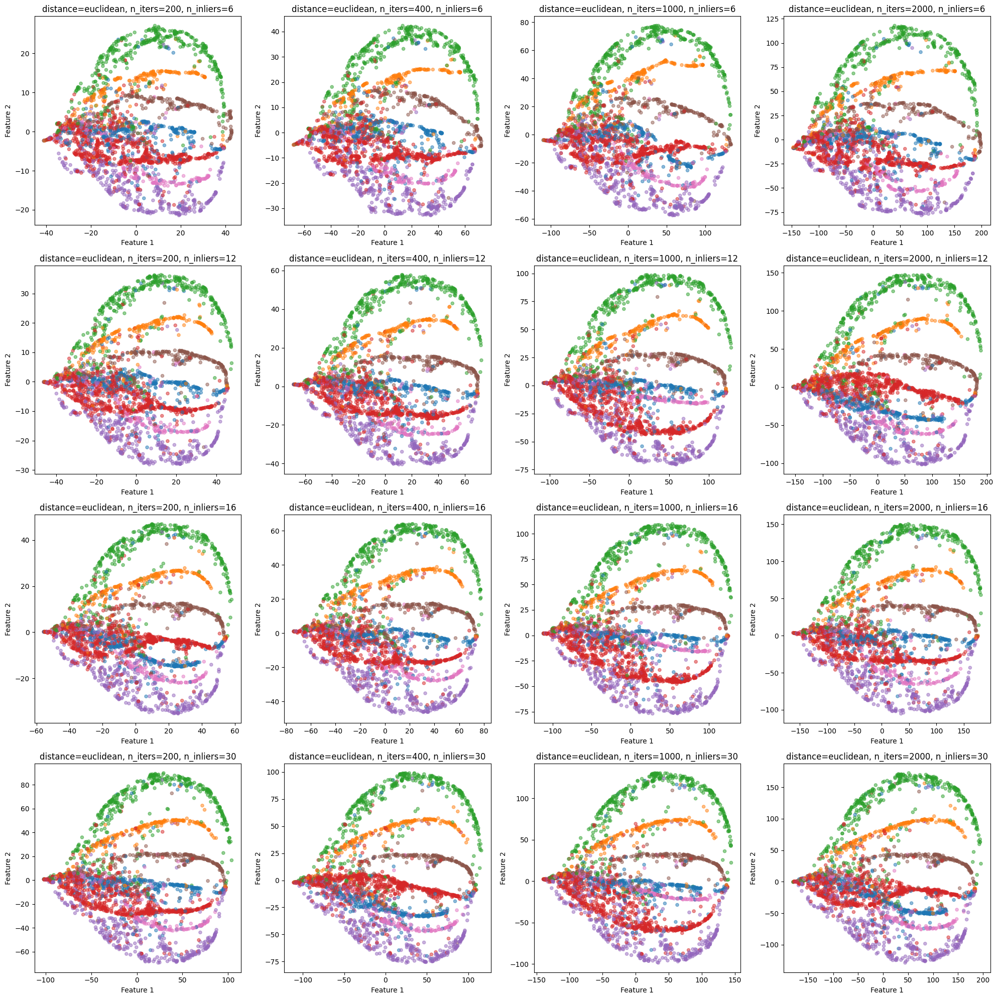

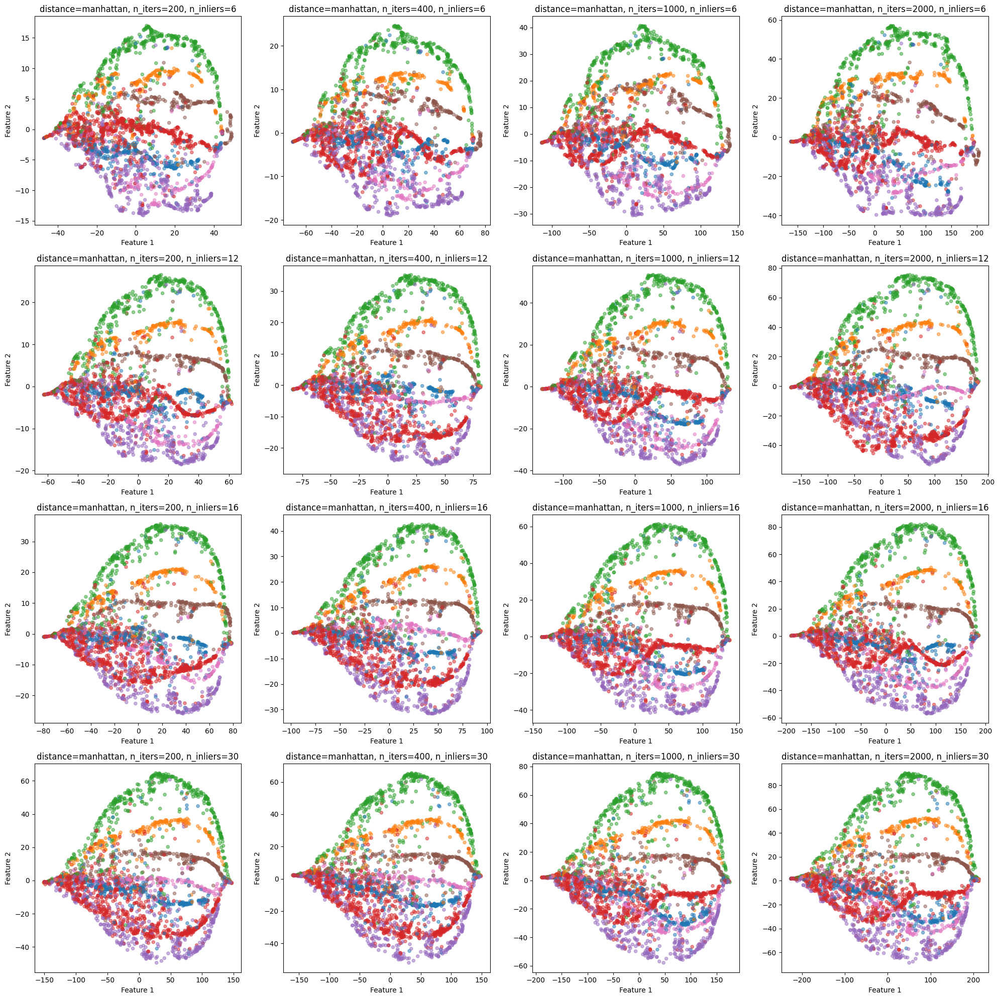

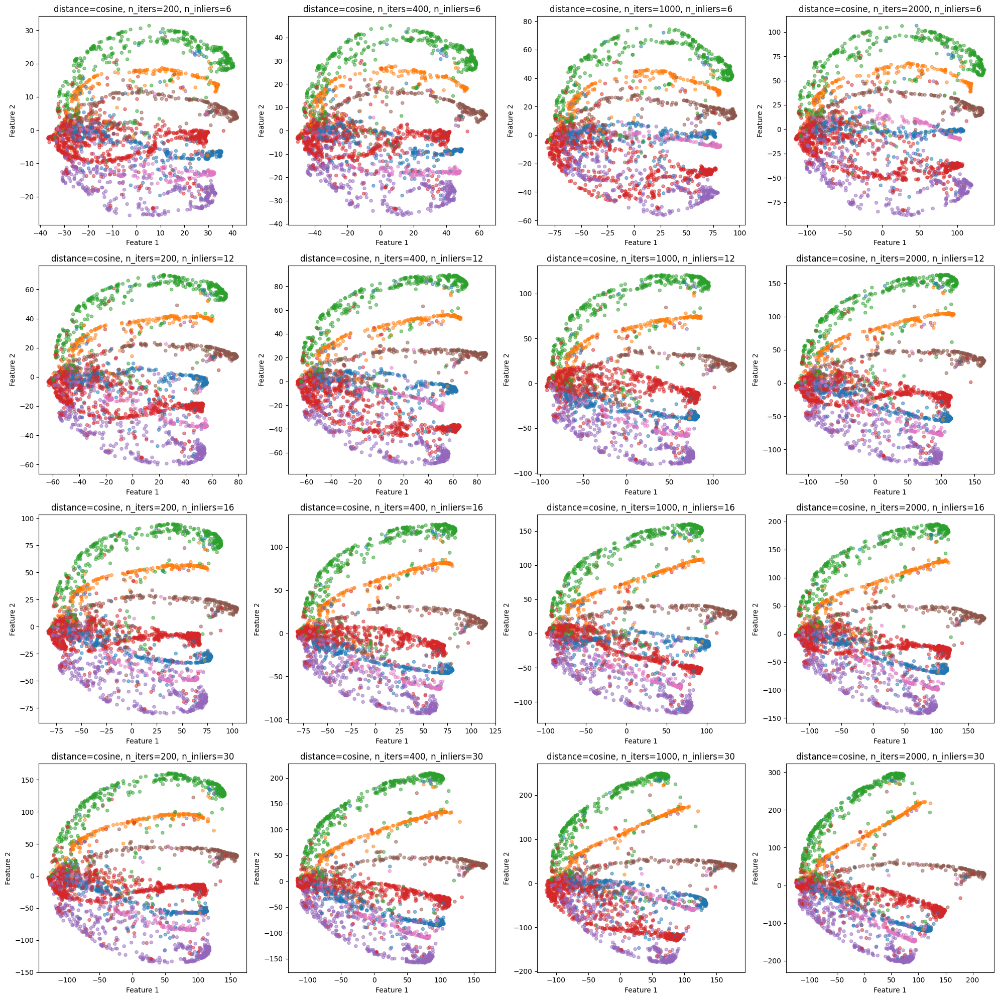

In [22]:
for distance in ['euclidean', 'manhattan', 'cosine']:
    fig, axs = plt.subplots(4, 4, figsize=(20, 20)) 
    axs = axs.flatten()
    i = 0
    for n_inliers in [6, 12, 16, 30]:
        for n_iters in [200, 400, 1000, 2000]:
            umap_post = TRIMAP(n_dims=2 , n_iters=n_iters, n_inliers=n_inliers, distance=distance)
            umap_results = umap_post.fit_transform(embeddings)
    
            plot_no_show(axs[i], umap_results, data_y_cpu, f'distance={distance}, n_iters={n_iters}, n_inliers={n_inliers}', size=20)

            i += 1


    plt.tight_layout()
    plt.show()

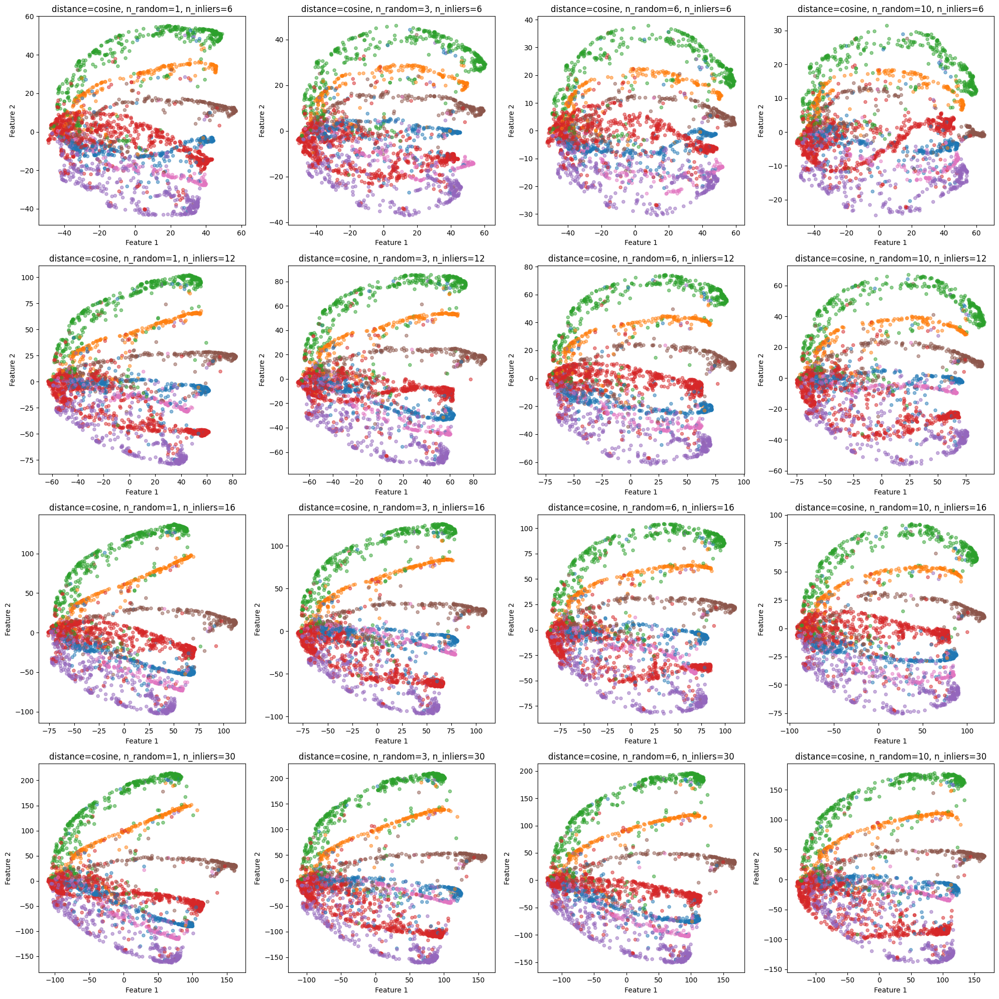

In [23]:
distance = 'cosine'
n_iters=400
for distance in ['cosine']:
    fig, axs = plt.subplots(4, 4, figsize=(20, 20)) 
    axs = axs.flatten()
    i = 0
    for n_inliers in [6, 12, 16, 30]:
        for n_random in [1, 3, 6, 10]:
            umap_post = TRIMAP(n_dims=2 , n_random=n_random, n_inliers=n_inliers, distance=distance)
            umap_results = umap_post.fit_transform(embeddings)
    
            plot_no_show(axs[i], umap_results, data_y_cpu, f'distance={distance}, n_random={n_random}, n_inliers={n_inliers}', size=20)

            i += 1


    plt.tight_layout()
    plt.show()

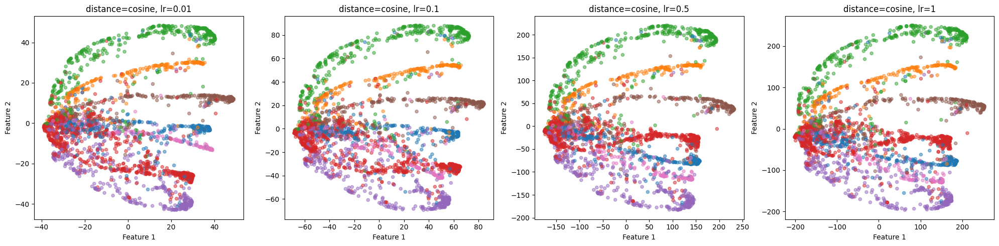

In [25]:
distance = 'cosine'
n_iters=400
fig, axs = plt.subplots(1, 4, figsize=(20, 5)) 
axs = axs.flatten()
i = 0

for lr in [0.01, 0.1, 0.5, 1]:
    umap_post = TRIMAP(n_dims=2, distance=distance, lr=lr)
    umap_results = umap_post.fit_transform(embeddings)

    plot_no_show(axs[i], umap_results, data_y_cpu, f'distance={distance}, lr={lr}', size=20)

    i += 1


plt.tight_layout()
plt.show()

The best distance seems to be **cosine**. Let's discard n_outliers=3 and n_inliners=0 and investigate further.

### 2.3 Fine-tuned TRIMAP vs default TRIMAP

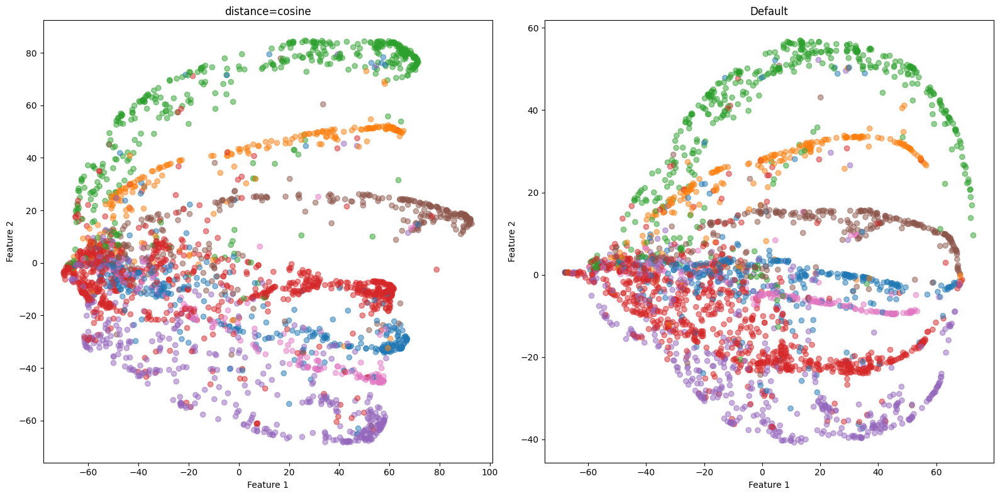

In [26]:
fig, axs = plt.subplots(1, 2, figsize=(16, 8)) 

distance='cosine'

umap_post = TRIMAP(n_dims=2, distance=distance)
umap_results = umap_post.fit_transform(embeddings)

plot_no_show(axs[0], umap_results, data_y_cpu, f'distance={distance}')

umap_post = TRIMAP(n_dims=2)
umap_results = umap_post.fit_transform(embeddings)

plot_no_show(axs[1], umap_results, data_y_cpu, f'Default')

plt.tight_layout()
plt.show()

The results are extremely poor. Let's investigate if manipulating model parameters will improve the outcome.

## 4. TRIMAP on original features

### 4.1 Default umap

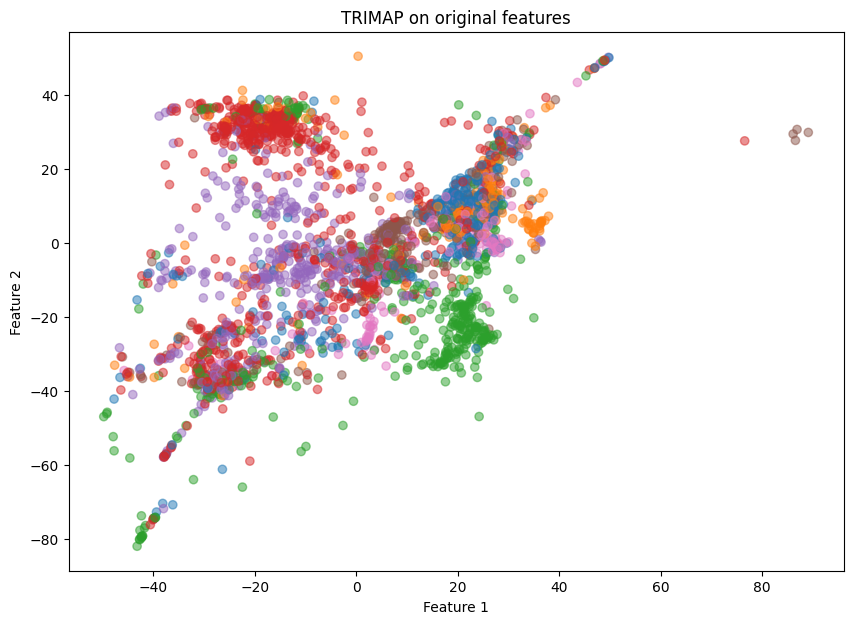

In [27]:
umap_post = TRIMAP(n_dims=2)
embeddings_umap_post = umap_post.fit_transform(data_x_cpu)

visualise(embeddings_umap_post, data_y_cpu, 'TRIMAP on original features')

### 4.2 Fine-tuning umap

#### 4.2.1 distance vs n_inliners vs n_outliers

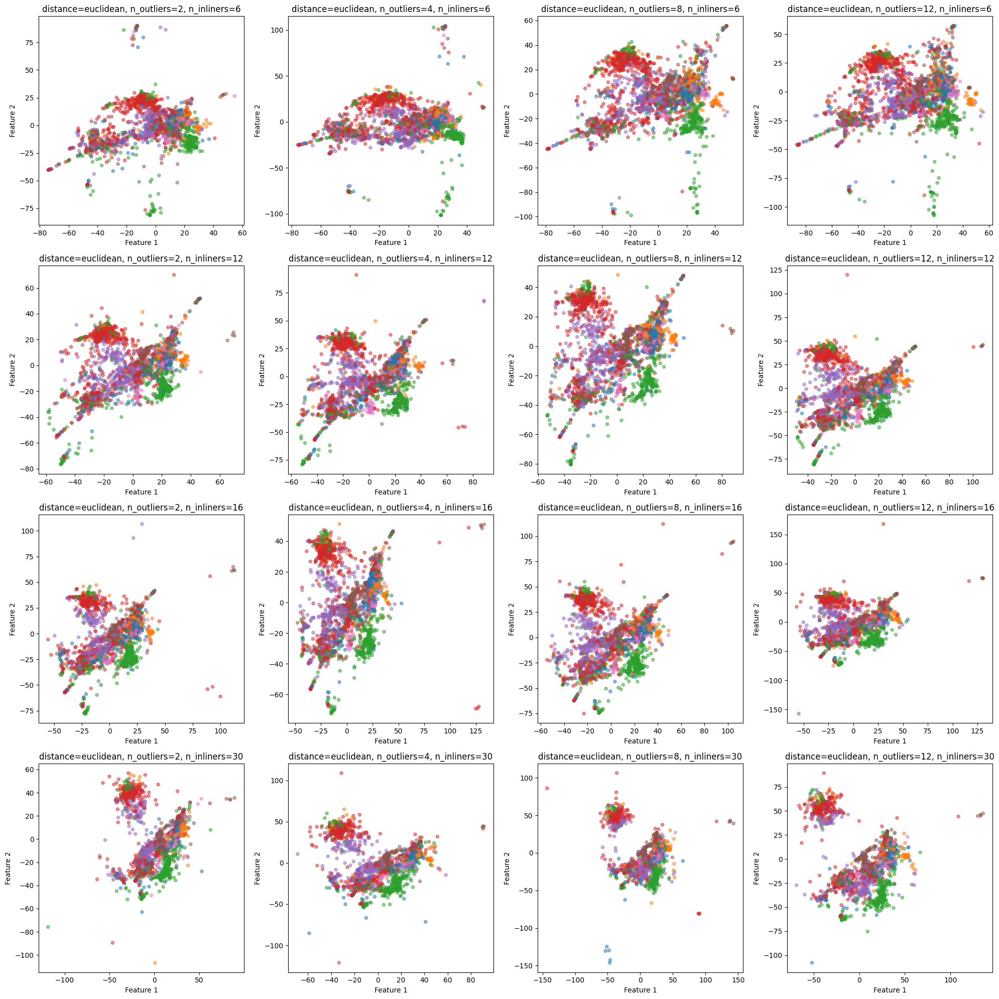

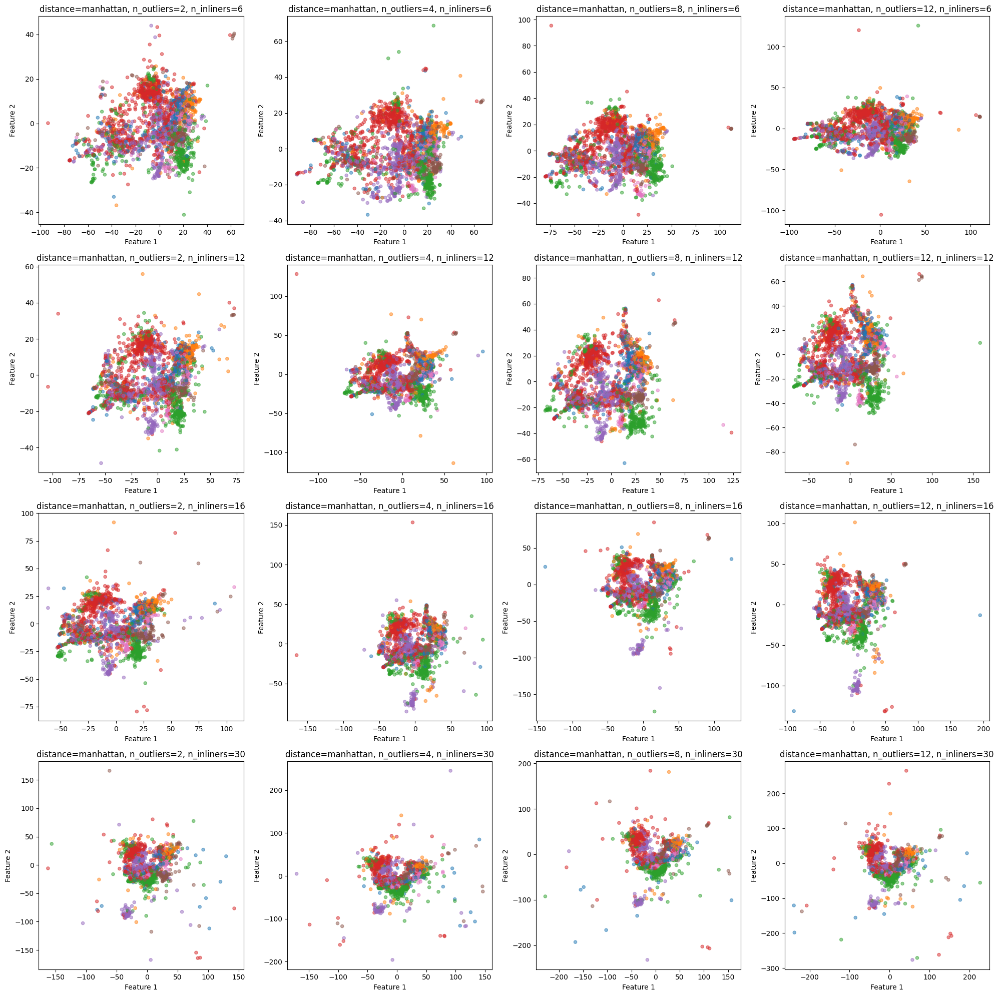

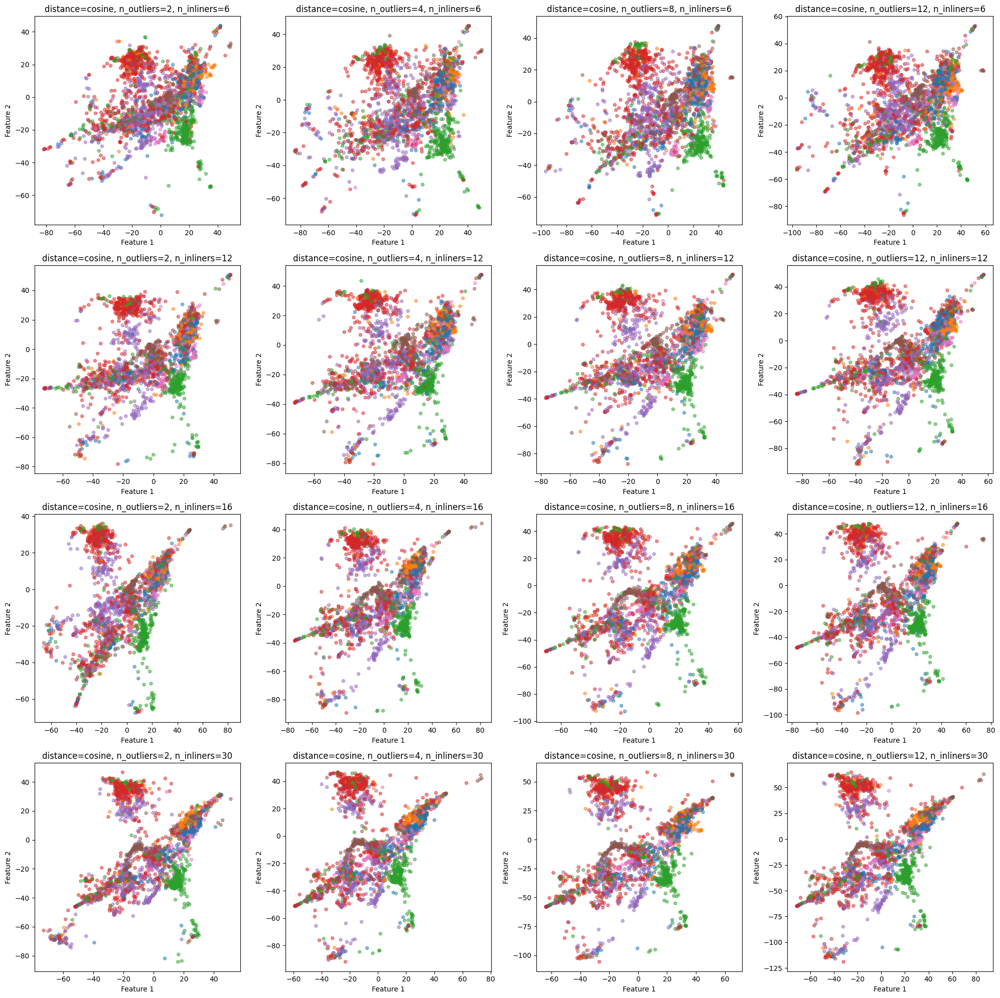

In [30]:
for distance in ['euclidean', 'manhattan', 'cosine']:
    fig, axs = plt.subplots(4, 4, figsize=(20, 20)) 
    axs = axs.flatten()
    i = 0
    for n_inliers in  [6, 12, 16, 30]:
        for n_outliers in [2, 4, 8, 12]:
        
            umap_post = TRIMAP(n_dims=2, n_outliers=n_outliers, n_inliers=n_inliers, distance=distance)
            umap_results = umap_post.fit_transform(data_x_cpu)
    
            plot_no_show(axs[i], umap_results, data_y_cpu, f'distance={distance}, n_outliers={n_outliers}, n_inliners={n_inliers}', size=20)

            i += 1


    plt.tight_layout()
    plt.show()



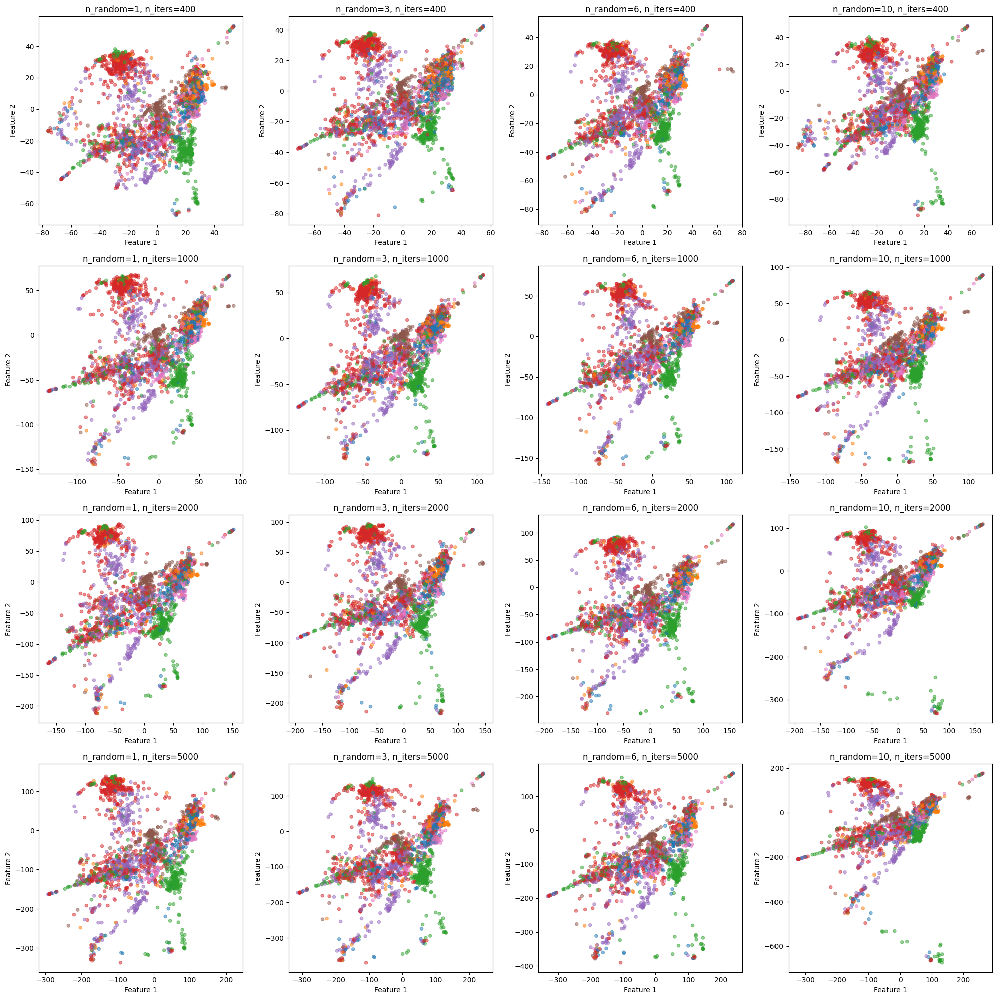

In [32]:
distance='cosine'
n_inliers=6
n_outliers=2


fig, axs = plt.subplots(4, 4, figsize=(20, 20)) 
axs = axs.flatten()
i = 0
for n_iters in [400, 1000, 2000, 5000]:
    for n_random in [1, 3, 6, 10]:
        umap_post = TRIMAP(n_dims=2 , n_random=n_random, n_iters=n_iters, distance=distance)
        umap_results = umap_post.fit_transform(data_x_cpu)

        plot_no_show(axs[i], umap_results, data_y_cpu, f'n_random={n_random}, n_iters={n_iters}', size=20)

        i += 1


plt.tight_layout()
plt.show()

### 4.3 Fine-tuned TRIMAP vs default TRIMAP

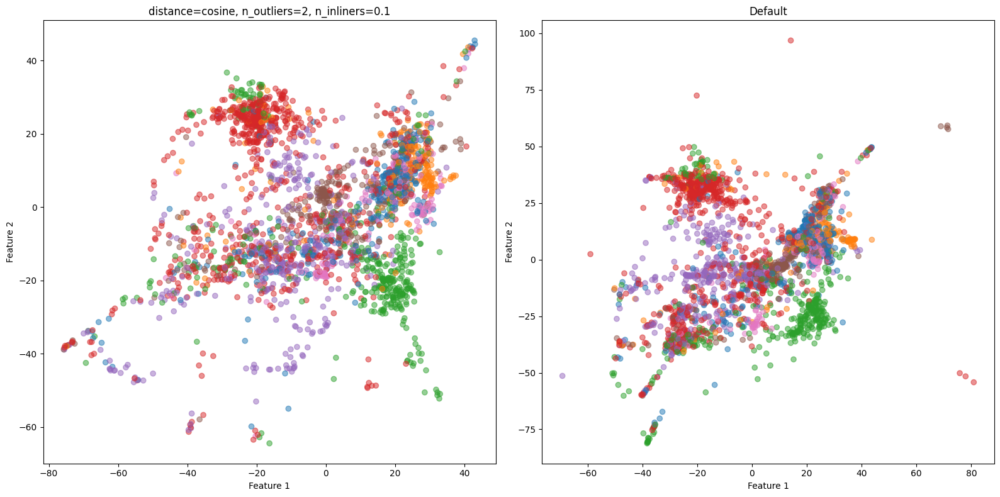

In [34]:
fig, axs = plt.subplots(1, 2, figsize=(16, 8)) 

distance='cosine'
n_inliers=6
n_outliers=2


umap_post = TRIMAP(n_dims=2, n_outliers=n_outliers, n_inliers=n_inliers, distance=distance)
umap_results = umap_post.fit_transform(data_x_cpu)

plot_no_show(axs[0], umap_results, data_y_cpu, f'distance={distance}, n_outliers={n_outliers}, n_inliners={n_inliners}')

umap_post = TRIMAP(n_dims=2)
umap_results = umap_post.fit_transform(data_x_cpu)

plot_no_show(axs[1], umap_results, data_y_cpu, f'Default')

plt.tight_layout()
plt.show()

## 5. TRIMAP on original features vs learned representations

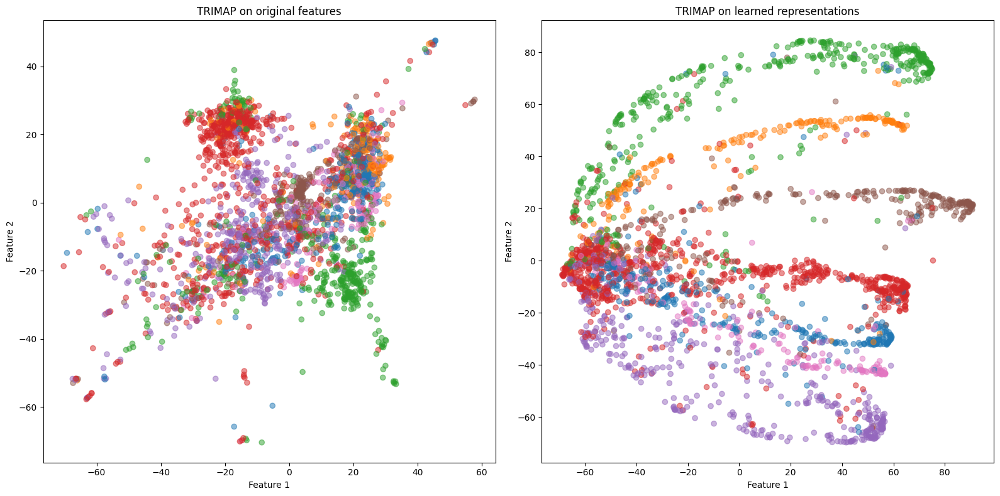

In [35]:
fig, axs = plt.subplots(1, 2, figsize=(16, 8)) 

distance='cosine'
n_inliers=6
n_outliers=2

umap_post = TRIMAP(n_dims=2, n_outliers=n_outliers, n_inliers=n_inliers, distance=distance)
umap_results = umap_post.fit_transform(data_x_cpu)

plot_no_show(axs[0], umap_results, data_y_cpu, f'TRIMAP on original features')

distance='cosine'

umap_post = TRIMAP(n_dims=2, distance=distance)
umap_results = umap_post.fit_transform(embeddings)

plot_no_show(axs[1], umap_results, data_y_cpu, f'TRIMAP on learned representations')

plt.tight_layout()
plt.show()

## 6. Final conclusions
**TRIMAP AS POSTPROCESSING STEP**

**Left plot: TRIMAP on original features**
- Feature overlap: There is a notable overlap among different classes, as indicated by the mingling of colors. This suggests that the original high-dimensional space does not easily allow for class separation.
- Global structure: TRIMAP has a tendency to maintain more of the global structure of the data compared to t-SNE, and this plot does show some broad groupings. However, the boundaries are not well-defined, which could imply that the original features alone may not be optimal for tasks that rely on clear class discrimination.


**Right plot: TRIMAP on learned representations**
- Improved clustering: The plot representing TRIMAP on the GNN's learned representations exhibits better clustering of similar data points (nodes). The colors representing different classes are more segregated into distinct clusters than in the original feature space.
- Class separation: The separation between clusters indicates that the GNN model is producing embeddings that encapsulate the structural and feature-related properties of the graph more effectively than the original features alone.
- Data manifold: The shape of the data distribution suggests that TRIMAP has captured a complex manifold where the GNN's learned representations reside. It indicates that the GNN has learned embeddings that reflect underlying data patterns conducive to node classification.


**TRIMAP AS PREPROCESSING STEP**
- TRIMAP applied as preprocessing step proved to be very fragile to fine-tuning.
- Default TRIMAP configuration performed very poorly, not exceeding 0.3 accuracy or other distances values.
- Fine-tuned TRIMAP performed much better although the distances still fell down by 5%.